<h1 align=center><font size = 5>An analysis of neighborhoods in London using data science methodologies</font></h1>

<br>
<img src="london-house-price.png" style="display: block; margin-left:auto; margin-right:auto; width:10%"/> <br>

## Introduction

## Table of Contents

<div class="alert alert-block alert-success" style="margin-top: 20px">

<font size = 3>

1.  <a href="#item1">Download and Explore Dataset</a>

2.  <a href="#item2">Explore Neighborhoods in the City of London</a>

3.  <a href="#item3">Analyze Each Neighborhood</a>

4.  <a href="#item4">Cluster Neighborhoods</a>

5.  <a href="#item5">Examine Clusters</a>  
    </font>
    </div>


<br>
<img src="Top 5 UK local A by annual growth.png" style="display: block; margin-left:auto; margin-right:auto; width:5%"/> <br>

# Daily Activity log  ( Here I must have to write what I have done and what I am planning to do the following day. 
   This will help save time. 
## Here I plotted the number of houses in each house type. 
**Ideas** 
- Plot price distribution for each type of house 
- Plot on a map where the houses are in the boroughs and show the price variation as color intensity. This will allow us to see which borough has higher values of house prices. 

- Plot



# Sources for the data 

## House Price index
   https://www.gov.uk/government/publications/uk-house-price-index-england-december-2019/uk-house-price-index-england-december-2019
    
## Housing in London 2020 Report
   https://data.london.gov.uk/dataset/housing-london
## House prices in London – an economic analysis of London’s housing market
   https://www.london.gov.uk/sites/default/files/house-prices-in-london.pdf

### Import all the dependencies

In [1]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

#conda install -c conda-forge geopy  # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.pyplot as plt
import branca.colormap as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

#!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
import folium # map rendering library

import seaborn as sns

print('Libraries imported.')

Libraries imported.


## 1. Download and Explore Dataset

In [2]:
#UK House Price paid data for only year 2020
df_lon = pd.read_csv("pp-2020.csv")
df_lon.head()
print(df_lon.shape)



(440420, 16)


In [3]:
df_lon.columns



Index(['{9DBAD221-7C16-6EB3-E053-6B04A8C0F257}', '200000', '2020-01-03 00:00',
       'LL32 8BS', 'T', 'N', 'F', '14', 'Unnamed: 8', 'ERSKINE TERRACE',
       'Unnamed: 10', 'CONWY', 'CONWY.1', 'CONWY.2', 'A', 'A.1'],
      dtype='object')

In [4]:
# UK House Price paid data for only year 2020
df_lon.head(6)



,{9DBAD221-7C16-6EB3-E053-6B04A8C0F257},200000,2020-01-03 00:00,LL32 8BS,T,N,F,14,Unnamed: 8,ERSKINE TERRACE,Unnamed: 10,CONWY,CONWY.1,CONWY.2,A,A.1
0,{9DBAD221-7C19-6EB3-E053-6B04A8C0F257},160000,2020-01-24 00:00,LL53 6HW,T,N,F,NEWBOROUGH HOUSE,NaN,STRYD Y FFYNNON,NEFYN,PWLLHELI,GWYNEDD,GWYNEDD,A,A
1,{9DBAD221-7C1D-6EB3-E053-6B04A8C0F257},85000,2020-01-17 00:00,SA44 4BD,T,N,F,2,NaN,CILGWYN ROW,NaN,LLANDYSUL,CEREDIGION,CEREDIGION,A,A
2,{9DBAD221-7C24-6EB3-E053-6B04A8C0F257},250000,2020-01-07 00:00,LL11 2PU,S,N,F,64,NaN,HAYTOR ROAD,NaN,WREXHAM,WREXHAM,WREXHAM,A,A
3,{9DBAD221-7C28-6EB3-E053-6B04A8C0F257},305000,2020-01-16 00:00,CH8 7SY,D,N,F,1,NaN,LLYS DELYN,NaN,HOLYWELL,FLINTSHIRE,FLINTSHIRE,A,A
4,{9DBAD221-7C32-6EB3-E053-6B04A8C0F257},83500,2020-01-02 00:00,SA14 6DR,S,N,F,36,NaN,HEOL Y BRYN,UPPER TUMBLE,LLANELLI,CARMARTHENSHIRE,CARMARTHENSHIRE,A,A
5,{9DBAD221-7C38-6EB3-E053-6B04A8C0F257},165000,2020-01-03 00:00,NP11 6BB,S,N,F,3,NaN,MARYLAND ROAD,RISCA,NEWPORT,CAERPHILLY,CAERPHILLY,A,A


In [ ]:
#df_lon.groupby('CONWY').count()
#print('There are {} uniques categories.'.format(len(manhattan_venues['Venue Category'].unique())))


In [5]:
#Extrating House Data for London only
df_london = df_lon[df_lon['CONWY'].str.match('LONDON')].reset_index()
df_london.head()


,index,{9DBAD221-7C16-6EB3-E053-6B04A8C0F257},200000,2020-01-03 00:00,LL32 8BS,T,N,F,14,Unnamed: 8,ERSKINE TERRACE,Unnamed: 10,CONWY,CONWY.1,CONWY.2,A,A.1
0,193,{A2479555-0F7F-74C7-E053-6B04A8C0887D},1200000,2020-03-03 00:00,W12 8NT,T,N,F,40,NaN,WARBECK ROAD,NaN,LONDON,HAMMERSMITH AND FULHAM,GREATER LONDON,A,A
1,863,{AE4D86D4-3CDE-4619-E053-6C04A8C03CD0},1360000,2020-07-06 00:00,N10 2DJ,T,N,F,6,NaN,GRASMERE ROAD,NaN,LONDON,HARINGEY,GREATER LONDON,A,A
2,866,{AE4D86D4-3CE1-4619-E053-6C04A8C03CD0},710000,2020-07-24 00:00,NW1 7TJ,F,N,L,"GLOUCESTER COURT, 33",FLAT 6,GLOUCESTER AVENUE,NaN,LONDON,CAMDEN,GREATER LONDON,A,A
3,868,{AE4D86D4-3CE3-4619-E053-6C04A8C03CD0},2515000,2020-07-20 00:00,N2 0QW,D,N,F,10,NaN,CHALTON DRIVE,NaN,LONDON,BARNET,GREATER LONDON,A,A
4,869,{AE4D86D4-3CE4-4619-E053-6C04A8C03CD0},340000,2020-07-24 00:00,N17 7PE,T,N,F,165,NaN,TOWER GARDENS ROAD,NaN,LONDON,HARINGEY,GREATER LONDON,A,A


### DROP columns that are not needed 

In [6]:

df_london_s = df_london.drop(['{9DBAD221-7C16-6EB3-E053-6B04A8C0F257}', '2020-01-03 00:00', 'N', 'F', 'Unnamed: 8', 'A', 'A.1'], axis = 1).reset_index()

In [7]:
#check column names
df_london_s.columns


Index(['level_0', 'index', '200000', 'LL32 8BS', 'T', '14', 'ERSKINE TERRACE',
       'Unnamed: 10', 'CONWY', 'CONWY.1', 'CONWY.2'],
      dtype='object')

### Rename index / columns names (labels) of DataFrame

In [8]:
df_london_s.rename(columns={'200000': 'Price', 'LL32 8BS' : 'pcd' , 'T': 'Type', 'CONWY.1' : 'Neighborhood'}, inplace=True)
df_london_s.columns

Index(['level_0', 'index', 'Price', 'pcd', 'Type', '14', 'ERSKINE TERRACE',
       'Unnamed: 10', 'CONWY', 'Neighborhood', 'CONWY.2'],
      dtype='object')

In [9]:
#Data df_london_s  now contain 'Price', postcode ('pcd'), 'Neighborhood' columns
df_london_s.head()



,level_0,index,Price,pcd,Type,14,ERSKINE TERRACE,Unnamed: 10,CONWY,Neighborhood,CONWY.2
0,0,193,1200000,W12 8NT,T,40,WARBECK ROAD,NaN,LONDON,HAMMERSMITH AND FULHAM,GREATER LONDON
1,1,863,1360000,N10 2DJ,T,6,GRASMERE ROAD,NaN,LONDON,HARINGEY,GREATER LONDON
2,2,866,710000,NW1 7TJ,F,"GLOUCESTER COURT, 33",GLOUCESTER AVENUE,NaN,LONDON,CAMDEN,GREATER LONDON
3,3,868,2515000,N2 0QW,D,10,CHALTON DRIVE,NaN,LONDON,BARNET,GREATER LONDON
4,4,869,340000,N17 7PE,T,165,TOWER GARDENS ROAD,NaN,LONDON,HARINGEY,GREATER LONDON


## # Get latitude and longitudes for postcodes in London in order to plot a map in folium

In [11]:
# Load london_postcodes-ons-postcodes-directory-MAY20 data that contain postcodes
df_postcode = pd.read_csv("Data/london_postcodes-ons-postcodes-directory-MAY20.csv")
df_postcode.head()
df_postcode.columns


/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3063: DtypeWarning: Columns (45) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


Index(['pcd', 'pcd2', 'pcds', 'dointr', 'doterm', 'oscty', 'ced', 'oslaua',
       'osward', 'parish', 'usertype', 'oseast1m', 'osnrth1m', 'osgrdind',
       'oshlthau', 'nhser', 'ctry', 'rgn', 'streg', 'pcon', 'eer', 'teclec',
       'ttwa', 'pct', 'nuts', 'statsward', 'oa01', 'casward', 'park', 'lsoa01',
       'msoa01', 'ur01ind', 'oac01', 'oa11', 'lsoa11', 'msoa11', 'wz11', 'ccg',
       'bua11', 'buasd11', 'ru11ind', 'oac11', 'lat', 'long', 'lep1', 'lep2',
       'pfa', 'imd', 'calncv', 'stp'],
      dtype='object')

In [12]:
#Merge postcode data with London House price data on postcode
df3 = pd.merge(df_london_s, df_postcode, on=['pcd'], how='inner')
df3.head()


,level_0,index,Price,pcd,Type,14,ERSKINE TERRACE,Unnamed: 10,CONWY,Neighborhood,CONWY.2,pcd2,pcds,dointr,doterm,oscty,ced,oslaua,osward,parish,usertype,oseast1m,osnrth1m,osgrdind,oshlthau,nhser,ctry,rgn,streg,pcon,eer,teclec,ttwa,pct,nuts,statsward,oa01,casward,park,lsoa01,msoa01,ur01ind,oac01,oa11,lsoa11,msoa11,wz11,ccg,bua11,buasd11,ru11ind,oac11,lat,long,lep1,lep2,pfa,imd,calncv,stp
0,0,193,1200000,W12 8NT,T,40,WARBECK ROAD,NaN,LONDON,HAMMERSMITH AND FULHAM,GREATER LONDON,W12 8NT,W12 8NT,198001,NaN,E99999999,E99999999,E09000013,E05000263,E43000203,0,522910,179956,1,E18000007,E40000003,E92000001,E12000007,5,E14000726,E15000007,E24000013,E30000234,E16000030,E05000263,00ANGP,E00009756,00ANGP,E99999999,E01001942,E02000376,5,7B1,E00009756,E01001942,E02000376,E33033875,E38000070,E34004707,E35000839,A1,3D3,51.505180,-0.230468,E37000023,NaN,E23000001,11283,E56000021,E54000027
1,1,863,1360000,N10 2DJ,T,6,GRASMERE ROAD,NaN,LONDON,HARINGEY,GREATER LONDON,N10 2DJ,N10 2DJ,198001,NaN,E99999999,E99999999,E09000014,E05000266,E43000204,0,528830,190556,1,E18000007,E40000003,E92000001,E12000007,5,E14000752,E15000007,E24000012,E30000234,E16000013,E05000266,00APGA,E00009846,00APGA,E99999999,E01001963,E02000405,5,7A3,E00009846,E01001963,E02000405,E33034031,E38000240,E34004707,E35000478,A1,4A3,51.599122,-0.141339,E37000023,NaN,E23000001,26300,E56000027,E54000028
2,19712,306425,1150000,N10 2DJ,T,10,GRASMERE ROAD,NaN,LONDON,HARINGEY,GREATER LONDON,N10 2DJ,N10 2DJ,198001,NaN,E99999999,E99999999,E09000014,E05000266,E43000204,0,528830,190556,1,E18000007,E40000003,E92000001,E12000007,5,E14000752,E15000007,E24000012,E30000234,E16000013,E05000266,00APGA,E00009846,00APGA,E99999999,E01001963,E02000405,5,7A3,E00009846,E01001963,E02000405,E33034031,E38000240,E34004707,E35000478,A1,4A3,51.599122,-0.141339,E37000023,NaN,E23000001,26300,E56000027,E54000028
3,2,866,710000,NW1 7TJ,F,"GLOUCESTER COURT, 33",GLOUCESTER AVENUE,NaN,LONDON,CAMDEN,GREATER LONDON,NW1 7TJ,NW1 7TJ,198001,NaN,E99999999,E99999999,E09000007,E05000130,E43000197,0,528494,183698,1,E18000007,E40000003,E92000001,E12000007,5,E14000750,E15000007,E24000014,E30000234,E16000047,E05000130,00AGGF,E00004204,00AGGF,E99999999,E01000862,E02000183,5,2B2,E00004204,E01000862,E02000183,E33033033,E38000240,E34004707,E35000865,A1,2D2,51.537568,-0.148693,E37000023,NaN,E23000001,23485,E56000027,E54000028
4,4,869,340000,N17 7PE,T,165,TOWER GARDENS ROAD,NaN,LONDON,HARINGEY,GREATER LONDON,N17 7PE,N17 7PE,198001,NaN,E99999999,E99999999,E09000014,E05000283,E43000204,0,532787,190593,1,E18000007,E40000003,E92000001,E12000007,5,E14001002,E15000007,E24000012,E30000234,E16000013,E05000283,00APGT,E00010509,00APGT,E99999999,E01002095,E02000402,5,7A2,E00010509,E01002095,E02000402,E33034019,E38000240,E34004707,E35000478,A1,4A3,51.598536,-0.084228,E37000023,NaN,E23000001,2671,E56000027,E54000028


In [33]:
df3.shape


(12413, 60)

In [34]:
#create a data dataframe with only required columns

London_data = df3[['Price', 'Type', 'pcd', 'oa11', 'Neighborhood', 'lat', 'long']]

London_data.head()

,Price,Type,pcd,oa11,Neighborhood,lat,long
0,1200000,T,W12 8NT,E00009756,HAMMERSMITH AND FULHAM,51.505180,-0.230468
1,1360000,T,N10 2DJ,E00009846,HARINGEY,51.599122,-0.141339
2,1150000,T,N10 2DJ,E00009846,HARINGEY,51.599122,-0.141339
3,710000,F,NW1 7TJ,E00004204,CAMDEN,51.537568,-0.148693
4,340000,T,N17 7PE,E00010509,HARINGEY,51.598536,-0.084228


In [15]:
London_data.describe()

,Price,lat,long
count,1.241300e+04,12413.000000,12413.000000
mean,9.526082e+05,51.528653,-0.103307
std,3.298396e+06,0.053788,0.093719
min,1.000000e+02,51.424547,-0.328851
25%,3.750000e+05,51.484973,-0.179752
50%,5.250000e+05,51.519761,-0.115595
75%,8.100000e+05,51.573934,-0.020117
max,2.100000e+08,51.671365,0.137295


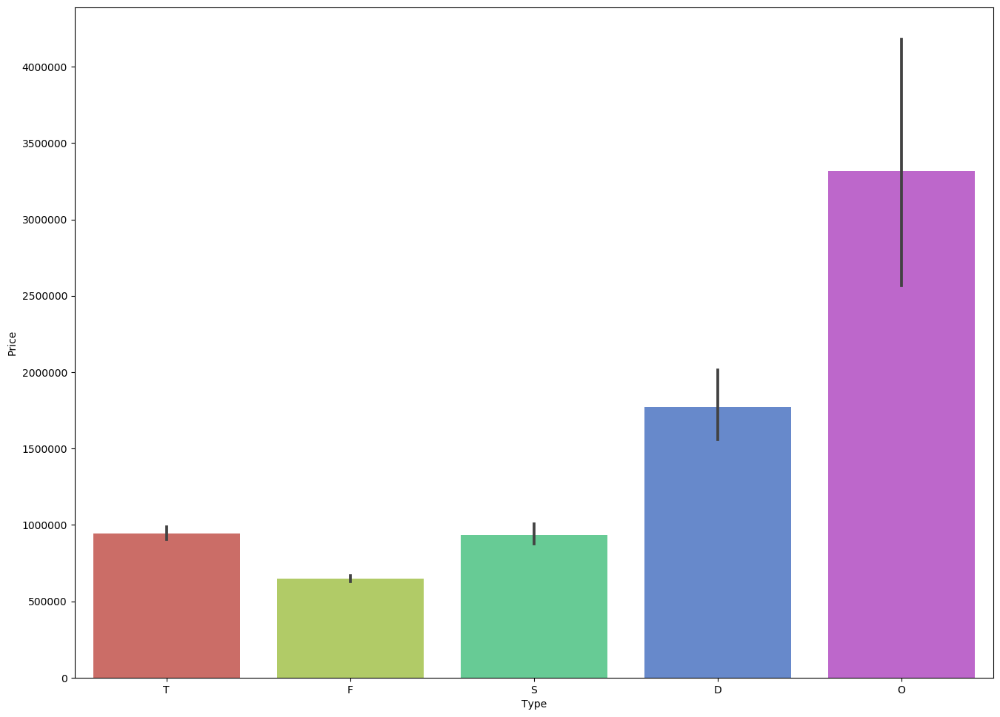

In [35]:
sns.barplot(x = London_data.Type, y = 'Price', data =London_data,
            palette = 'hls', 
                      
              
            )

#print(titanic.groupby(['sex', 'class']).mean()['survived'])
#print(titanic.groupby(['sex', 'class']).std()['survived'])
plt.rcParams['figure.figsize'] = [16, 12]
plt.rcParams['figure.dpi'] = 100 # 200 e.g. is really fine, but slower
plt.show()

In [37]:
London_Data_Flat = London_data[London_data['Type'].str.match('F')].reset_index()
London_Data_Flat.head()
#Find property that has maximum sale price. 
London_Data_Flat.max()

index                12412
Price             35500000
Type                     F
pcd                W1W 8ER
oa11             E00176594
Neighborhood    WANDSWORTH
lat                51.6488
long              0.137295
dtype: object

### One Flat has a price  of 35.5 million so removed that

In [38]:
# A new investor will probably not invest in properties that has price greater than 1m. So discard house prices above 1 million
London_Data_Flat_1m = London_Data_Flat[London_Data_Flat['Price'] < 1000000 ].reset_index()



In [39]:
London_Data_Flat_1m.head()
#Sort data according to price 
London_Data_Flat_1m_s = London_Data_Flat_1m.sort_values(by = ['Price'], ascending =False)
#remove outlier 
London_Data_Flat_1m_s2 = London_Data_Flat_1m_s.iloc[0:6230, : ]
London_Data_Flat_1m_s2.head()


,level_0,index,Price,Type,pcd,oa11,Neighborhood,lat,long
273,289,517,999999,F,SW8 1BG,E00171529,LAMBETH,51.482583,-0.125086
4383,4961,8035,999995,F,NW1 5SQ,E00023921,CITY OF WESTMINSTER,51.523085,-0.157540
941,1072,1627,999000,F,SE3 9GL,E00008092,GREENWICH,51.461438,0.026932
394,441,690,998775,F,SW8 1BN,E00171529,LAMBETH,51.482583,-0.125086
3704,4199,6664,998352,F,E1W 2AR,E00021625,TOWER HAMLETS,51.508818,-0.067158


In [40]:
London_Data_Flat_1m_s2['Price'].describe()

count      6230.000000
mean     467751.609470
std      186394.733927
min       87500.000000
25%      335000.000000
50%      435000.000000
75%      575000.000000
max      999999.000000
Name: Price, dtype: float64

In [41]:
#find median price
London_Data_Flat_1m_s2['Price'].median()

435000.0

Text(0.5, 1.0, 'Prices of Flat in London')

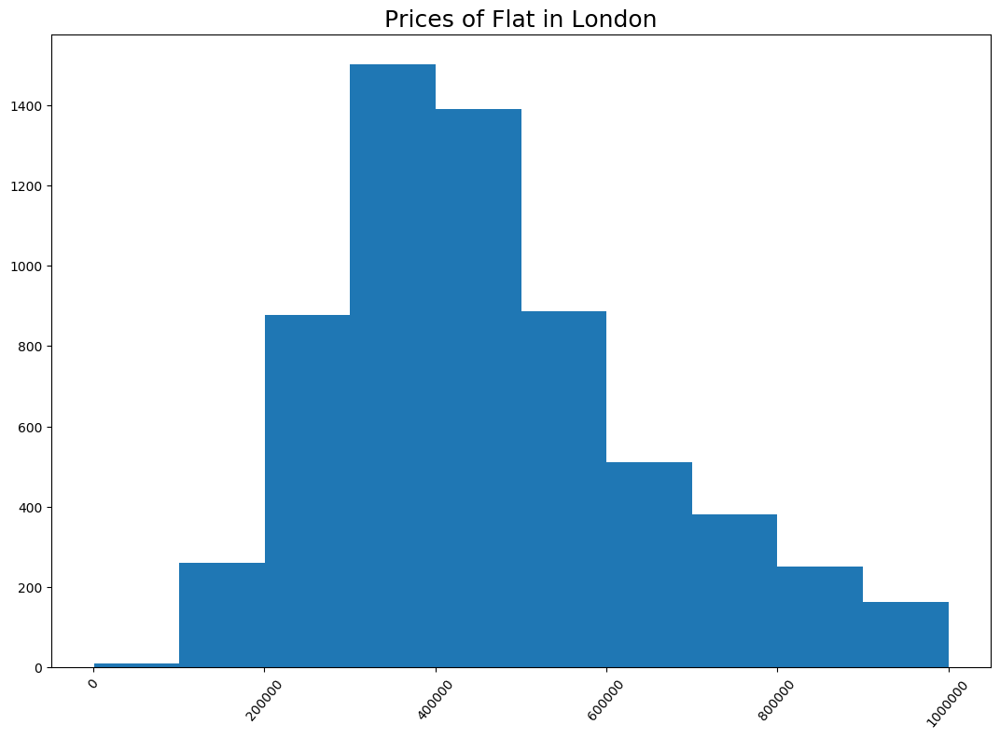

In [42]:
#lines = London_Data_Flat.plot.line('Price')
plt.figure(figsize = (13,9))
plt.hist(London_Data_Flat_1m_s['Price'])
plt.xticks(rotation= 50)
plt.title('Prices of Flat in London', fontdict={'fontsize': 18})


In [43]:
#sns.distplot(London_data['Price'], kde = True, color = 'b', hist_kws={'alpha': 0.9})



In [44]:
Residential_type = London_data.groupby('Type').count()
Residential_type.columns
Lon_dat = London_data.head(100)
Lon_dat.head()



,Price,Type,pcd,oa11,Neighborhood,lat,long
0,1200000,T,W12 8NT,E00009756,HAMMERSMITH AND FULHAM,51.505180,-0.230468
1,1360000,T,N10 2DJ,E00009846,HARINGEY,51.599122,-0.141339
2,1150000,T,N10 2DJ,E00009846,HARINGEY,51.599122,-0.141339
3,710000,F,NW1 7TJ,E00004204,CAMDEN,51.537568,-0.148693
4,340000,T,N17 7PE,E00010509,HARINGEY,51.598536,-0.084228


## Plot a price distrbution plot

level_0      3534.518376
index        5743.705344
Price      467676.637297
lat            51.522364
long           -0.101650
dtype: float64


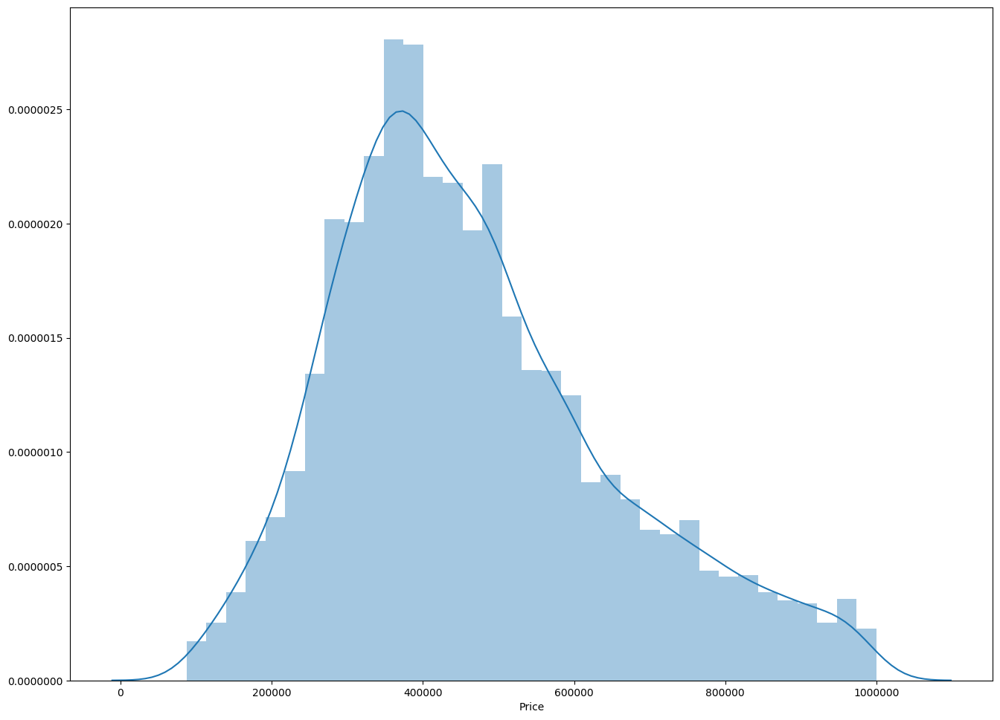

In [45]:
print(London_Data_Flat_1m.mean())
ax = sns.distplot( London_Data_Flat_1m_s2["Price"])




## EDA Exploratotory Data Analysis annual price change by local authorities

In [46]:
import json
with open('Counties_and_Unitary_Authorities__December_2016__Boundaries.geojson') as json_data:
    UK_data = json.load(json_data)


In [48]:
pwd


'/Users/sz742/Documents/02-Programming and Machine Learning/ IBM Data Science Professional Certificate/Course 9-Applied Data Science Capstone'

In [49]:
address = 'London, UK'

geolocator = Nominatim(user_agent="to_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of London are {}, {}.'.format(latitude, longitude))


The geograpical coordinate of London are 51.5073219, -0.1276474.


In [51]:
map_circle = folium.Map(location = [latitude, longitude], zoom_start = 10)



In [52]:
map_London = folium.Map(location=[latitude, longitude], zoom_start=11)

# add markers to map
for lat, lng, label in zip(London_data['lat'], London_data['long'], London_data['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_London)  
    
map_London

In [53]:
# create map of London using latitude and longitude values
map_london = folium.Map(location=[latitude, longitude], zoom_start=14)

colormap = cm.LinearColormap(colors = ['blue', 'green', 'orange', 'yellow', 'red'], vmin = 100000, vmax = 1000000)
# add markers to map

for i in range(len(London_Data_Flat_1m_s2)):
    folium.Circle(
        location = [London_Data_Flat_1m_s2.iloc[i]['lat'], London_Data_Flat_1m_s2.iloc[i]['long']],
        radius=10,
        color = colormap(London_Data_Flat_1m_s2.iloc[i]['Price']) ,
        fill=True,
        #fill_color='#3186cc',
        fill_opacity=0.2,
        legend_name = "Variation of Flats Prices sold in London in 2020",
        ).add_to(map_london)  
    
map_london.add_child(colormap)

In [54]:
# create a LinearColorMap and assign colors, vmin, and vmax
# the colormap will show green for $100,000 homes all the way up to red for £999999 homes
colormap = cm.LinearColormap(colors=['green', 'yellow', 'red'], vmin=200000, vmax=500000)

# create our map again.  This time I am using a different tileset for a new look
m = folium.Map(location=[latitude, longitude], zoom_start=10, tiles='Stamen Toner')

# Same as before... go through each home in set, make circle, and add to map.
# This time we add a color using price and the colormap object
for i in range(len(London_Data_Flat_1m_s2)):
    folium.Circle(
        location=[London_Data_Flat_1m_s2.iloc[i]['lat'], London_Data_Flat_1m_s2.iloc[i]['long']],
        radius=10,
        fill=True,
        color=colormap(London_Data_Flat_1m_s2.iloc[i]['Price']),
        fill_opacity=0.2
    ).add_to(m)

# the following line adds the scale directly to our map
m.add_child(colormap)

# Save map 
m.save('price_colormap.html')
m

In [ ]:
import shapefile


***

Let's write the code below that creates the choropleth map

In [253]:
import folium
import json
import numpy as np

# this line just to force our dataset zipcodes from numbers to strings so they match our geojson file
# df['zipcode'] = df['zipcode'].astype('str')


# # load my geojson file which contains my Polygons
# boundary_file = "geojson_files/Zipcodes_for_King_County_and_Surrounding_Area__Shorelines____zipcode_shore_area.geojson"
# with open(boundary_file, 'r') as f:
#     zipcode_boundary = json.load(f)

    
# Grab my map center again using our created fucntion (same as before)
#center = get_center_latlong(df)


# Initialize Folium Map again (same as before)
m = folium.Map(location=[latitude, longitude], 
               zoom_start=10,
               tiles='Stamen Toner')


# Use the groupby method to 
# zipcode_data = df.groupby('zipcode').aggregate(np.mean)
# zipcode_data.reset_index(inplace = True)


# Create choropleth map  
folium.Choropleth(
    geo_data=UK_data,
    name='choropleth',
    data=London_Data_Flat_1m_s2,
    columns=['Neighborhood', 'Price'],
    key_on='objects.lad.geometries.properties.LAD13NM',
    fill_color='Spectral',
    fill_opacity=0.6,
    nan_fill_opacity=0,
    line_opacity=1,
    legend_name='Mean Price'
).add_to(m)


m.save('zipcode_choropleth.html') 

AttributeError: 'NoneType' object has no attribute 'get'

***